In [28]:
%pip install pandas
%pip install opencv-python
%pip install matplotlib
%pip install ultralytics

You should consider upgrading via the 'c:\Personal Documents\Mtech\semester 4\Project\JupyterCode\virtual2\Scripts\python.exe -m pip install --upgrade pip' command.


Note: you may need to restart the kernel to use updated packages.


You should consider upgrading via the 'c:\Personal Documents\Mtech\semester 4\Project\JupyterCode\virtual2\Scripts\python.exe -m pip install --upgrade pip' command.


Note: you may need to restart the kernel to use updated packages.


You should consider upgrading via the 'c:\Personal Documents\Mtech\semester 4\Project\JupyterCode\virtual2\Scripts\python.exe -m pip install --upgrade pip' command.


Note: you may need to restart the kernel to use updated packages.


You should consider upgrading via the 'c:\Personal Documents\Mtech\semester 4\Project\JupyterCode\virtual2\Scripts\python.exe -m pip install --upgrade pip' command.


IMPORTS

In [29]:
import os
from os import walk
import pandas as pd
import shutil
import cv2
import matplotlib.pyplot as plt

STATIC VARS

In [30]:
OUTPUT_DIR = "YOLO/"
VISUALIZATION = "YOLO/visuals/"
DATASET_PATH = '../Data/CropAndWeed/'

In [31]:
data = {}

for (dirpath, dirnames, filenames) in walk('..\Data\CropAndWeed\images'):
    for filename in filenames:
        f_name = filename.split('.')[0]
        if(data.get(f_name)):
            data[f_name]['image_path'] = os.path.join(os.path.normpath(dirpath), filename)
        else:
             data[f_name] = {'image_path': os.path.join(os.path.normpath(dirpath), filename)}

for (dirpath, dirnames, filenames) in walk('..\Data\CropAndWeed\\bboxes'):
    for filename in filenames:
        f_name = filename.split('.')[0]
        if(data.get(f_name)):
            data[f_name]['bboxes_path'] = os.path.join(os.path.normpath(dirpath), filename)
        else:
             data[f_name] = {'bboxes_path': os.path.join(os.path.normpath(dirpath), filename)}


for (dirpath, dirnames, filenames) in walk('..\Data\CropAndWeed\labelIds\CropAndWeed'):
    for filename in filenames:
        f_name = filename.split('.')[0]
        if(data.get(f_name)):
            data[f_name]['labelIds_path'] = os.path.join(os.path.normpath(dirpath), filename)
        else:
             data[f_name] = {'labelIds_path': os.path.join(os.path.normpath(dirpath), filename)}

for (dirpath, dirnames, filenames) in walk('..\Data\CropAndWeed\params'):
    for filename in filenames:
        f_name = filename.split('.')[0]
        if(data.get(f_name)):
            data[f_name]['params_path'] = os.path.join(os.path.normpath(dirpath), filename)
        else:
             data[f_name] = {'params_path': os.path.join(os.path.normpath(dirpath), filename)}

print(data['ave-0000-0001'])

{'image_path': '..\\Data\\CropAndWeed\\images\\ave-0000-0001.jpg', 'bboxes_path': '..\\Data\\CropAndWeed\\bboxes\\ave-0000-0001.csv', 'labelIds_path': '..\\Data\\CropAndWeed\\labelIds\\CropAndWeed\\ave-0000-0001.png', 'params_path': '..\\Data\\CropAndWeed\\params\\ave-0000-0001.csv'}


In [90]:
def convert_csv_to_yolo_txt(csv_path, dest_path, img_height=1088, img_width=1920):
    try:
        csv_df = pd.read_csv(csv_path, header=None)
    except Exception as e:
        print('Exception occured while reading csv :', csv_path, e)
        csv_df = pd.DataFrame()

    yolo_boxes = []

    for i, row in csv_df.iterrows():
        left = row[0]
        top = row[1]
        right = row[2]
        bottom = row[3]
        label = row[4]
        
        center_x = ((left + right) / 2) / img_width
        center_y = ((top + bottom) / 2) / img_height
        width = (right - left) / img_width
        height = (bottom - top) / img_height

        yolo_box =  f"{label} {center_x} {center_y} {width} {height}"

        yolo_boxes.append(yolo_box)
        

    try:
        # print(yolo_boxes)
        with open(dest_path, 'w+') as yolo_file:
            yolo_file.write("\n".join(yolo_boxes))   
    except Exception as e :
        print(e)

    

In [105]:
def create_req_dirs(os_dir):
    if not os.path.exists(os_dir):
        os.makedirs(os_dir)
    if not os.path.exists(os_dir+'/images'):
        os.makedirs(os_dir+'/images')
    if not os.path.exists(os_dir+'/lables'):
            os.makedirs(os_dir+'/lables')
    if not os.path.exists(os_dir+'/visuals'):
        os.makedirs(os_dir+'/visuals')

In [106]:
create_req_dirs(OUTPUT_DIR)

In [91]:
def convert_data_to_yolo_format(images_details, o_dir):
    for key in images_details:
        image_src_path = data[key]['image_path']
        image_dst_path = os.path.normpath(o_dir + 'images/' + key + '.jpg')
        # shutil.copy(image_src_path, image_dst_path)

        csv_src_path = data[key]['bboxes_path']
        txt_dst_path = os.path.join('./' + o_dir , 'lables/' + key + '.txt')

        print(txt_dst_path)
        convert_csv_to_yolo_txt(csv_src_path, txt_dst_path)





In [92]:
convert_data_to_yolo_format(data, OUTPUT_DIR)

./YOLO/lables/ave-0000-0001.txt
./YOLO/lables/ave-0000-0002.txt
Exception occured while reading csv : ..\Data\CropAndWeed\bboxes\ave-0000-0002.csv No columns to parse from file
./YOLO/lables/ave-0000-0005.txt
Exception occured while reading csv : ..\Data\CropAndWeed\bboxes\ave-0000-0005.csv No columns to parse from file
./YOLO/lables/ave-0007-0000.txt
./YOLO/lables/ave-0007-0007.txt
./YOLO/lables/ave-0032-0006.txt
./YOLO/lables/ave-0035-0001.txt
./YOLO/lables/ave-0035-0002.txt
./YOLO/lables/ave-0035-0003.txt
./YOLO/lables/ave-0035-0004.txt
./YOLO/lables/ave-0035-0005.txt
./YOLO/lables/ave-0035-0006.txt
./YOLO/lables/ave-0035-0007.txt
./YOLO/lables/ave-0035-0008.txt
./YOLO/lables/ave-0035-0009.txt
./YOLO/lables/ave-0035-0010.txt
./YOLO/lables/ave-0035-0011.txt
./YOLO/lables/ave-0035-0012.txt
./YOLO/lables/ave-0035-0013.txt
./YOLO/lables/ave-0035-0014.txt
./YOLO/lables/ave-0035-0015.txt
./YOLO/lables/ave-0035-0017.txt
./YOLO/lables/ave-0035-0018.txt
./YOLO/lables/ave-0035-0019.txt
./YOLO

In [32]:
label_data = {
    0: ('Soil', (0, 0, 0)),
    1: ('Maize', (255, 0, 0)),
    2: ('Maize two-leaf stage', (234, 0, 0)),
    3: ('Maize four-leaf stage', (212, 0, 0)),
    4: ('Maize six-leaf stage', (191, 0, 0)),
    5: ('Maize eight-leaf stage', (170, 0, 0)),
    6: ('Maize max', (149, 0, 0)),
    7: ('Sugar beet', (255, 85, 0)),
    8: ('Sugar beet two-leaf stage', (234, 78, 0)),
    9: ('Sugar beet four-leaf stage', (212, 71, 0)),
    10: ('Sugar beet six-leaf stage', (191, 64, 0)),
    11: ('Sugar beet eight-leaf stage', (170, 57, 0)),
    12: ('Sugar beet Max', (149, 50, 0)),
    13: ('Pea', (255, 170, 0)),
    14: ('Courgette', (255, 255, 0)),
    15: ('Pumpkins', (170, 255, 0)),
    16: ('Radish', (85, 255, 0)),
    17: ('Asparagus', (0, 255, 0)),
    18: ('Potato', (0, 255, 85)),
    19: ('Flat leaf parsley', (0, 255, 170)),
    20: ('Curly leaf parsley', (0, 255, 255)),
    21: ('Cowslip', (0, 170, 255)),
    22: ('Poppy', (0, 85, 255)),
    23: ('Hemp', (0, 0, 255)),
    24: ('Sunflower', (85, 0, 255)),
    25: ('Sage', (170, 0, 255)),
    26: ('Common bean', (255, 0, 255)),
    27: ('Faba bean', (255, 0, 170)),
    28: ('Clover', (255, 0, 85)),
    29: ('Hybrid goosefoot', (255, 188, 178)),
    30: ('Black-bindweed', (255, 207, 178)),
    31: ('Cockspur grass', (255, 226, 178)),
    32: ('Red-root amaranth', (255, 245, 178)),
    33: ('White goosefoot', (245, 255, 178)),
    34: ('Thorn apple', (226, 255, 178)),
    35: ('Potato weed', (207, 255, 178)),
    36: ('German chamomile', (188, 255, 178)),
    37: ('Saltbush', (178, 255, 188)),
    38: ('Creeping thistle', (178, 255, 207)),
    39: ('Field milk thistle', (178, 255, 226)),
    40: ('Purslane', (178, 255, 245)),
    41: ('Black nightshade', (178, 245, 255)),
    42: ('Mercuries', (178, 226, 255)),
    43: ('Spurge', (178, 207, 255)),
    44: ('Pale persicaria', (178, 188, 255)),
    45: ('Geraniums', (188, 178, 255)),
    46: ('Cleavers', (207, 178, 255)),
    47: ('Whitetop', (226, 178, 255)),
    48: ('Meadow-grass', (245, 178, 255)),
    49: ('Frosted orach', (255, 178, 245)),
    50: ('Black horehound', (255, 178, 226)),
    51: ('Shepherds purse', (255, 178, 207)),
    52: ('Field bindweed', (255, 178, 188)),
    53: ('Common mugwort', (255, 194, 178)),
    54: ('Hedge mustard', (255, 213, 178)),
    55: ('Groundsel', (255, 219, 178)),
    56: ('Speedwell', (255, 232, 178)),
    57: ('Broadleaf plantain', (255, 238, 178)),
    58: ('White ball-mustard', (255, 251, 178)),
    59: ('Peppermint', (255, 212, 0)),
    60: ('Field pennycress', (239, 255, 178)),
    61: ('Corn spurry', (233, 255, 178)),
    62: ('Purple crabgrass', (220, 255, 178)),
    63: ('Common fumitory', (214, 255, 178)),
    64: ('Ivy-leaved speedwell', (201, 255, 178)),
    65: ('Annual meadow grass', (195, 255, 178)),
    66: ('Redshank', (182, 255, 178)),
    67: ('Common hemp-nettle', (178, 255, 194)),
    68: ('Rough meadow-grass', (178, 255, 200)),
    69: ('Green bristlegrass', (178, 255, 213)),
    70: ('Small geranium', (178, 255, 220)),
    71: ('Cornflower', (178, 255, 232)),
    72: ('Common corn-cockle', (178, 255, 238)),
    73: ('Creeping crowfoot', (178, 255, 251)),
    74: ('Wall barley', (178, 239, 255)),
    75: ('Annual fescue', (178, 233, 255)),
    76: ('Purple dead-nettle', (178, 220, 255)),
    77: ('Ribwort plantain', (178, 214, 255)),
    78: ('Pineappleweed', (178, 201, 255)),
    79: ('Common chickweed', (178, 195, 255)),
    80: ('Hedge mustard', (178, 182, 255)),
    81: ('Soft brome', (194, 178, 255)),
    82: ('Wild pansy', (200, 178, 255)),
    83: ('Yellow rocket', (213, 178, 255)),
    84: ('Common wild oat', (219, 178, 255)),
    85: ('Red poppy', (232, 178, 255)),
    86: ('Rye brome', (238, 178, 255)),
    87: ('Knotgrass', (251, 178, 255)),
    88: ('Prickly lettuce', (255, 178, 239)),
    89: ('Copse-bindweed', (255, 178, 233)),
    90: ('Manyseeds', (255, 178, 220)),
    91: ('Common buckwheat', (255, 178, 214)),
    92: ('Chives', (212, 255, 0)),
    93: ('Garlic', (127, 255, 0)),
    94: ('Soybean', (42, 255, 0)),
    95: ('Wild carrot', (244, 255, 0)),
    96: ('Field mustard', (159, 255, 0)),
    97: ('Giant fennel', (74, 255, 0)),
    98: ('Common horsetail', (10, 255, 0)),
    99: ('Common dandelion', (202, 255, 0)),
    100: ('Vegetation', (128, 128, 128))}

In [33]:
print([x[0] for x in list(label_data.values())])

['Soil', 'Maize', 'Maize two-leaf stage', 'Maize four-leaf stage', 'Maize six-leaf stage', 'Maize eight-leaf stage', 'Maize max', 'Sugar beet', 'Sugar beet two-leaf stage', 'Sugar beet four-leaf stage', 'Sugar beet six-leaf stage', 'Sugar beet eight-leaf stage', 'Sugar beet Max', 'Pea', 'Courgette', 'Pumpkins', 'Radish', 'Asparagus', 'Potato', 'Flat leaf parsley', 'Curly leaf parsley', 'Cowslip', 'Poppy', 'Hemp', 'Sunflower', 'Sage', 'Common bean', 'Faba bean', 'Clover', 'Hybrid goosefoot', 'Black-bindweed', 'Cockspur grass', 'Red-root amaranth', 'White goosefoot', 'Thorn apple', 'Potato weed', 'German chamomile', 'Saltbush', 'Creeping thistle', 'Field milk thistle', 'Purslane', 'Black nightshade', 'Mercuries', 'Spurge', 'Pale persicaria', 'Geraniums', 'Cleavers', 'Whitetop', 'Meadow-grass', 'Frosted orach', 'Black horehound', 'Shepherds purse', 'Field bindweed', 'Common mugwort', 'Hedge mustard', 'Groundsel', 'Speedwell', 'Broadleaf plantain', 'White ball-mustard', 'Peppermint', 'Fiel

In [34]:
def visualize_bounding_box(image_path, box_path, visual_path):
    image = cv2.imread(image_path)

    bboxes = []
    with open(box_path, 'r') as file:
        for line in file.readlines():
            parts = line.strip().split()
            class_id = int(parts[0])  # Class ID
            center_x = float(parts[1])  # Center X
            center_y = float(parts[2])  # Center Y
            width = float(parts[3])  # Width
            height = float(parts[4])  # Height
            bboxes.append((class_id, center_x, center_y, width, height))

    for bbox in bboxes:
        class_id, center_x, center_y, width, height = bbox
        
        # Convert YOLO format to pixel values
        img_height, img_width = image.shape[:2]
        left = int((center_x - width / 2) * img_width)
        top = int((center_y - height / 2) * img_height)
        right = int((center_x + width / 2) * img_width)
        bottom = int((center_y + height / 2) * img_height)

        label, color = label_data.get(class_id)

        # Draw the rectangle
        cv2.rectangle(image, (left, top), (right, bottom), color, 2)  # Green rectangle
        # Add label text
        cv2.putText(image, label, (left, top - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5,color, 2)

    print(visual_path)
    cv2.imwrite(visual_path, image)

In [114]:
for key in data:
    image_name = key
    image_path_ = './YOLO/images/'+image_name+'.jpg'
    box_path_ = './YOLO/lables/'+image_name+'.txt'
    vis_path = './' +VISUALIZATION+ image_name+'.jpg'
    visualize_bounding_box(image_path_, box_path_, vis_path)

./YOLO/visuals/ave-0000-0001.jpg
./YOLO/visuals/ave-0000-0002.jpg
./YOLO/visuals/ave-0000-0005.jpg
./YOLO/visuals/ave-0007-0000.jpg
./YOLO/visuals/ave-0007-0007.jpg
./YOLO/visuals/ave-0032-0006.jpg
./YOLO/visuals/ave-0035-0001.jpg
./YOLO/visuals/ave-0035-0002.jpg
./YOLO/visuals/ave-0035-0003.jpg
./YOLO/visuals/ave-0035-0004.jpg
./YOLO/visuals/ave-0035-0005.jpg
./YOLO/visuals/ave-0035-0006.jpg
./YOLO/visuals/ave-0035-0007.jpg
./YOLO/visuals/ave-0035-0008.jpg
./YOLO/visuals/ave-0035-0009.jpg
./YOLO/visuals/ave-0035-0010.jpg
./YOLO/visuals/ave-0035-0011.jpg
./YOLO/visuals/ave-0035-0012.jpg
./YOLO/visuals/ave-0035-0013.jpg
./YOLO/visuals/ave-0035-0014.jpg
./YOLO/visuals/ave-0035-0015.jpg
./YOLO/visuals/ave-0035-0017.jpg
./YOLO/visuals/ave-0035-0018.jpg
./YOLO/visuals/ave-0035-0019.jpg
./YOLO/visuals/ave-0035-0020.jpg
./YOLO/visuals/ave-0037-0001.jpg
./YOLO/visuals/ave-0037-0002.jpg
./YOLO/visuals/ave-0037-0007.jpg
./YOLO/visuals/ave-0037-0008.jpg
./YOLO/visuals/ave-0037-0009.jpg
./YOLO/vis

DATA VISUALIZATION

In [ ]:
def load_data_yolo(image_folder, bbox_folder):
    images_data = []
    bounding_box_count = 0
    for image_path in os.listdir(image_folder):
        image = cv2.imread(image_folder+'/'+ image_path)

        box_file_name = os.path.splitext(image_path)[0] + '.txt'
        box_file_path = os.path.join(bbox_folder, box_file_name)

        if os.path.exists(box_file_path):
            with open(box_file_path, 'r') as box_file:
                bounding_boxes = []

                for line in box_file.readlines():
                    parts = line.strip().split()
                    class_id = int(parts[0])  # Class ID
                    center_x = float(parts[1])  # Center X
                    center_y = float(parts[2])  # Center Y
                    width = float(parts[3])  # Width
                    height = float(parts[4])  # Height
                    bounding_boxes.append({
                        'label_id': class_id,
                        'left': center_x,
                        'top': center_y,
                        'right': width,
                        'bottom': height
                        })
                    
                    bounding_box_count+=1

        images_data.append((image_path, image, bounding_boxes))        
                    
        # break
    
    print("TOTAL BOUNDING BOXES :" , bounding_box_count)
    print("TOTAL IMAGES LOADED : ", len(images_data))
    return images_data


In [7]:
all_image_data = load_data_yolo('./YOLO/images', './YOLO/lables')

TOTAL BOUNDING BOXES : 111953
TOTAL IMAGES LOADED :  8034


In [35]:
def bbox_statistics(images):
    all_bboxes = []
    
    for _, _, bboxes in images:
        all_bboxes.extend(bboxes)
    
    bbox_df = pd.DataFrame(all_bboxes)
    
    # Count unique classes
    class_counts = bbox_df['label_id'].value_counts()
    print("Class Distribution:\n", class_counts)

    # Compute box dimensions
    bbox_df['width'] = bbox_df['right'] - bbox_df['left']
    bbox_df['height'] = bbox_df['bottom'] - bbox_df['top']
    
    print("Bounding Box Width Statistics:\n", bbox_df['width'].describe())
    print("Bounding Box Height Statistics:\n", bbox_df['height'].describe())

    plt.figure(figsize=(25, 6))
    
    
    plt.subplot(1, 2, 1)
    # bbox_df['label_name'] = bbox_df.apply(lambda row : label_data.get(row['label_id'])[0], axis=1)

    plt.hist(bbox_df['label_id'], color='blue', alpha=0.7, edgecolor='white', bins=100)
    plt.title('Bounding Box Label Distribution')
    plt.xlabel('Label')
    plt.ylabel('Frequency')

    plt.xticks(rotation=90)
    plt.tick_params(axis='x', which='major', labelsize=10)

    plt.tight_layout()
    plt.show()

    print(set(bbox_df['label_id'].to_list()))

Class Distribution:
 label_id
255    33000
69     12132
70      4428
94      4039
1       3992
       ...  
58         2
93         2
49         1
99         1
50         1
Name: count, Length: 85, dtype: int64
Bounding Box Width Statistics:
 count    111953.000000
mean         -0.461772
std           0.282300
min          -0.999219
25%          -0.689583
50%          -0.455208
75%          -0.235417
max           0.500000
Name: width, dtype: float64
Bounding Box Height Statistics:
 count    111953.000000
mean         -0.424111
std           0.286042
min          -0.998621
25%          -0.644761
50%          -0.409467
75%          -0.202665
max           0.500000
Name: height, dtype: float64


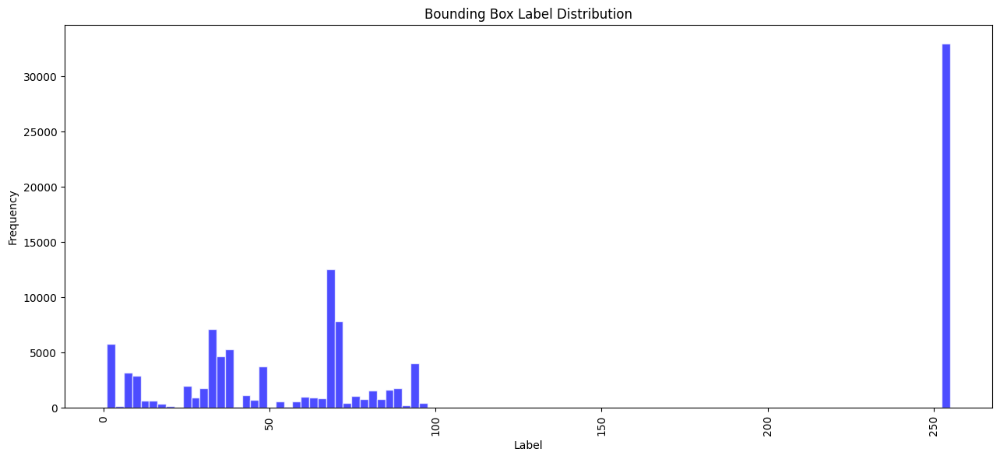

{1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 18, 19, 20, 21, 22, 24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 42, 45, 46, 48, 49, 50, 51, 52, 53, 54, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 68, 69, 70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 91, 93, 94, 95, 96, 99, 255}


In [36]:
bbox_statistics(all_image_data)


In [37]:
def check_missing_data(images):
    for img_name, _, bboxes in images:
        if not bboxes:
            print(f"Missing bounding boxes for image: {img_name}")
        
        for bbox in bboxes:
            if bbox['right'] < bbox['left'] or bbox['bottom'] < bbox['top']:
                print(f"Invalid bounding box for image {img_name}: {bbox}")

check_missing_data(all_image_data)

Invalid bounding box for image ave-0000-0001.jpg: {'label_id': 48, 'left': 0.23984375, 'top': 0.3147977941176471, 'right': 0.015104166666666667, 'bottom': 0.024816176470588234}
Missing bounding boxes for image: ave-0000-0002.jpg
Missing bounding boxes for image: ave-0000-0005.jpg
Invalid bounding box for image ave-0007-0000.jpg: {'label_id': 83, 'left': 0.06770833333333333, 'top': 0.0625, 'right': 0.011458333333333333, 'bottom': 0.029411764705882353}
Invalid bounding box for image ave-0007-0000.jpg: {'label_id': 35, 'left': 0.15703125, 'top': 0.046875, 'right': 0.009895833333333333, 'bottom': 0.027573529411764705}
Invalid bounding box for image ave-0007-0000.jpg: {'label_id': 255, 'left': 0.16432291666666668, 'top': 0.05376838235294118, 'right': 0.005729166666666666, 'bottom': 0.017463235294117647}
Invalid bounding box for image ave-0007-0000.jpg: {'label_id': 255, 'left': 0.18333333333333332, 'top': 0.04825367647058824, 'right': 0.005208333333333333, 'bottom': 0.019301470588235295}
In

TRAIN TEST SPLIT

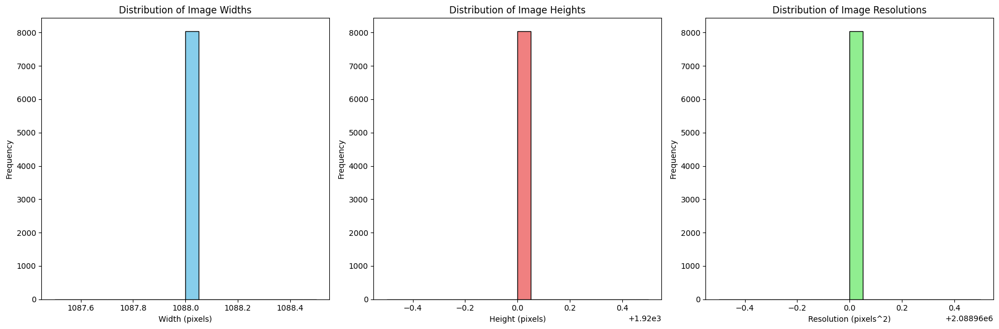

Image Width Statistics:
Mean: 1088.00
Median: 1088.00
Standard Deviation: 0.00
Min: 1088
Max: 1088

Image Height Statistics:
Mean: 1920.00
Median: 1920.00
Standard Deviation: 0.00
Min: 1920
Max: 1920

Image Resolution Statistics:
Mean: 2088960.00
Median: 2088960.00
Standard Deviation: 0.00
Min: 2088960
Max: 2088960


In [26]:
import numpy as np
def analyze_image_dimensions(image_dir):
    """
    Analyzes image dimensions (width and height) from a directory of images.

    Args:
        image_dir: Path to the directory containing image files.

    Returns:
        None. Displays histograms of image widths and heights and prints statistics.
    """

    widths = []
    heights = []
    resolutions = []

    for filename in os.listdir(image_dir):
        if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif', '.tiff')):  # Check for common image extensions
            filepath = os.path.join(image_dir, filename)
            try:
                img =  cv2.imread(filepath)
                width, height = img.shape[0], img.shape[1]
                widths.append(width)
                heights.append(height)
                resolutions.append(width * height)
            
            except Exception as e:
                print(f"Error processing {filename}: {e}")

    if not widths: #check if the list is empty to prevent errors
        print("No images found in the directory.")
        return

    # Plot histograms
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 3, 1)
    plt.hist(widths, bins=20, color='skyblue', edgecolor='black')
    plt.title('Distribution of Image Widths')
    plt.xlabel('Width (pixels)')
    plt.ylabel('Frequency')

    plt.subplot(1, 3, 2)
    plt.hist(heights, bins=20, color='lightcoral', edgecolor='black')
    plt.title('Distribution of Image Heights')
    plt.xlabel('Height (pixels)')
    plt.ylabel('Frequency')

    plt.subplot(1, 3, 3)
    plt.hist(resolutions, bins=20, color='lightgreen', edgecolor='black')
    plt.title('Distribution of Image Resolutions')
    plt.xlabel('Resolution (pixels^2)')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

    # Print summary statistics
    print("Image Width Statistics:")
    print(f"Mean: {np.mean(widths):.2f}")
    print(f"Median: {np.median(widths):.2f}")
    print(f"Standard Deviation: {np.std(widths):.2f}")
    print(f"Min: {np.min(widths)}")
    print(f"Max: {np.max(widths)}")

    print("\nImage Height Statistics:")
    print(f"Mean: {np.mean(heights):.2f}")
    print(f"Median: {np.median(heights):.2f}")
    print(f"Standard Deviation: {np.std(heights):.2f}")
    print(f"Min: {np.min(heights)}")
    print(f"Max: {np.max(heights)}")
    
    print("\nImage Resolution Statistics:")
    print(f"Mean: {np.mean(resolutions):.2f}")
    print(f"Median: {np.median(resolutions):.2f}")
    print(f"Standard Deviation: {np.std(resolutions):.2f}")
    print(f"Min: {np.min(resolutions)}")
    print(f"Max: {np.max(resolutions)}")


# Example usage:
image_directory = "./YOLO/images/"  # Replace with the actual path
analyze_image_dimensions(image_directory)

In [96]:
import random
def split_dataset(image_dir, label_dir, output_dir, train_ratio=0.7, val_ratio=0.2, test_ratio=0.1):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    for subdir in ['train', 'val', 'test']:
        os.makedirs(os.path.join(output_dir, subdir, 'images'), exist_ok=True)
        os.makedirs(os.path.join(output_dir, subdir, 'labels'), exist_ok=True)
    
    image_files = [f for f in os.listdir(image_dir) if os.path.isfile(os.path.join(image_dir, f))]
    label_files = [f for f in os.listdir(label_dir) if os.path.isfile(os.path.join(label_dir, f))]
    
    image_names = [os.path.splitext(f)[0] for f in image_files]
    label_names = [os.path.splitext(f)[0] for f in label_files]

    common_files = list(set(image_names) & set(label_names))

    if len(common_files) != len(image_files) or len(common_files) != len(label_files):
        print("WARNING: Not all images have corresponding labels, or vice versa.")
        image_files = [f + ".jpg" for f in common_files]
        label_files = [f + ".txt" for f in common_files]
    
    combined = list(zip(image_files, label_files))
    random.shuffle(combined)
    image_files, label_files = zip(*combined)

    num_files = len(image_files)
    train_split = int(num_files * train_ratio)
    val_split = int(num_files * (train_ratio + val_ratio))

    datasets = {
        'train': (image_files[:train_split], label_files[:train_split]),
        'val': (image_files[train_split:val_split], label_files[train_split:val_split]),
        'test': (image_files[val_split:], label_files[val_split:]),
    }

    for dataset_name, (image_list, label_list) in datasets.items():
        for image_file, label_file in zip(image_list, label_list):
            shutil.copy(os.path.join(image_dir, image_file), os.path.join(output_dir, dataset_name, 'images', image_file))
            shutil.copy(os.path.join(label_dir, label_file), os.path.join(output_dir, dataset_name, 'labels', label_file))



In [97]:
image_directory = './YOLO/images'  # Replace with your image directory
label_directory = './YOLO/lables'  # Replace with your label directory
output_directory = './splitDataset'  # Where the split data will be saved
split_dataset(image_directory, label_directory, output_directory)

In [98]:
%pip install opencv-python ultralytics

  Using cached PyYAML-6.0.2-cp39-cp39-win_amd64.whl.metadata (2.1 kB)
  Using cached requests-2.32.3-py3-none-any.whl.metadata (4.6 kB)
  Using cached scipy-1.13.1-cp39-cp39-win_amd64.whl.metadata (60 kB)
  Using cached charset_normalizer-3.4.1-cp39-cp39-win_amd64.whl.metadata (36 kB)
  Using cached idna-3.10-py3-none-any.whl.metadata (10 kB)
  Using cached urllib3-2.3.0-py3-none-any.whl.metadata (6.5 kB)
  Using cached certifi-2024.12.14-py3-none-any.whl.metadata (2.3 kB)
  Using cached networkx-3.2.1-py3-none-any.whl.metadata (5.2 kB)
  Using cached mpmath-1.3.0-py3-none-any.whl.metadata (8.6 kB)
   ---------------------------------------- 0.0/906.9 kB ? eta -:--:--
   --------------------------------------- 906.9/906.9 kB 10.2 MB/s eta 0:00:00
Using cached PyYAML-6.0.2-cp39-cp39-win_amd64.whl (162 kB)
Using cached requests-2.32.3-py3-none-any.whl (64 kB)
Using cached scipy-1.13.1-cp39-cp39-win_amd64.whl (46.2 MB)
   ---------------------------------------- 0.0/203.0 MB ? eta -:--:--

In [2]:
import cv2
from ultralytics import YOLO

In [3]:
model = YOLO("/content/yolo11l.pt")

In [4]:
# Train the model
results = model.train(data="./splitDataset/weed.yaml", epochs=20, imgsz=512)

Ultralytics 8.3.63  Python-3.9.13 torch-2.5.1+cpu CPU (11th Gen Intel Core(TM) i7-11850H 2.50GHz)
engine\trainer: task=detect, mode=train, model=/content/yolo11l.pt, data=./splitDataset/weed.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=512, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train14, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, s

train: Scanning C:\Personal Documents\Mtech\semester 4\Project\JupyterCode\splitDataset\train\labels.cache... 5623 images, 173 backgrounds, 3548 corrupt: 100%|██████████| 5623/5623 [00:00<?, ?it/s]

train: WARNING  C:\Personal Documents\Mtech\semester 4\Project\JupyterCode\splitDataset\train\images\ave-0007-0000.jpg: ignoring corrupt image/label: Label class 255 exceeds dataset class count 101. Possible class labels are 0-100
train: WARNING  C:\Personal Documents\Mtech\semester 4\Project\JupyterCode\splitDataset\train\images\ave-0007-0007.jpg: ignoring corrupt image/label: Label class 255 exceeds dataset class count 101. Possible class labels are 0-100
train: WARNING  C:\Personal Documents\Mtech\semester 4\Project\JupyterCode\splitDataset\train\images\ave-0032-0006.jpg: ignoring corrupt image/label: Label class 255 exceeds dataset class count 101. Possible class labels are 0-100
train: WARNING  C:\Personal Documents\Mtech\semester 4\Project\JupyterCode\splitDataset\train\images\ave-0035-0003.jpg: ignoring corrupt image/label: Label class 255 exceeds dataset class count 101. Possible class labels are 0-100
train: WARNING  C:\Personal Documents\Mtech\semester 4\Project\JupyterCode\s


val: Scanning C:\Personal Documents\Mtech\semester 4\Project\JupyterCode\splitDataset\val\labels.cache... 1607 images, 46 backgrounds, 1009 corrupt: 100%|██████████| 1607/1607 [00:00<?, ?it/s]

val: WARNING  C:\Personal Documents\Mtech\semester 4\Project\JupyterCode\splitDataset\val\images\ave-0035-0004.jpg: ignoring corrupt image/label: Label class 255 exceeds dataset class count 101. Possible class labels are 0-100
val: WARNING  C:\Personal Documents\Mtech\semester 4\Project\JupyterCode\splitDataset\val\images\ave-0035-0005.jpg: ignoring corrupt image/label: Label class 255 exceeds dataset class count 101. Possible class labels are 0-100
val: WARNING  C:\Personal Documents\Mtech\semester 4\Project\JupyterCode\splitDataset\val\images\ave-0035-0012.jpg: ignoring corrupt image/label: Label class 255 exceeds dataset class count 101. Possible class labels are 0-100
val: WARNING  C:\Personal Documents\Mtech\semester 4\Project\JupyterCode\splitDataset\val\images\ave-0035-0013.jpg: ignoring corrupt image/label: Label class 255 exceeds dataset class count 101. Possible class labels are 0-100
val: WARNING  C:\Personal Documents\Mtech\semester 4\Project\JupyterCode\splitDataset\val\im

Plotting labels to c:\Personal Documents\Mtech\runs\detect\train14\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=9.5e-05, momentum=0.9) with parameter groups 167 weight(decay=0.0), 174 weight(decay=0.0005), 173 bias(decay=0.0)
Image sizes 512 train, 512 val
Using 0 dataloader workers
Logging results to c:\Personal Documents\Mtech\runs\detect\train14
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20         0G      1.334      4.086      1.144         79        512: 100%|██████████| 130/130 [46:28<00:00, 21.45s/it] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:24<00:00,  7.60s/it]

                   all        598       2921      0.651      0.129     0.0733     0.0538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20         0G      1.079      2.467      1.018        109        512: 100%|██████████| 130/130 [35:57<00:00, 16.60s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:24<00:00,  7.61s/it]

                   all        598       2921      0.622      0.144      0.146      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20         0G      1.039      2.025      1.011         85        512: 100%|██████████| 130/130 [35:50<00:00, 16.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:22<00:00,  7.52s/it]

                   all        598       2921      0.602      0.177      0.175      0.131



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20         0G     0.9987      1.716      1.001        123        512: 100%|██████████| 130/130 [36:00<00:00, 16.62s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:23<00:00,  7.54s/it]

                   all        598       2921      0.495       0.24      0.201      0.146



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20         0G       0.96      1.523     0.9851        116        512: 100%|██████████| 130/130 [35:50<00:00, 16.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:22<00:00,  7.51s/it]

                   all        598       2921      0.518      0.264      0.267      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20         0G     0.9307      1.367     0.9787         97        512: 100%|██████████| 130/130 [35:38<00:00, 16.45s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:21<00:00,  7.42s/it]

                   all        598       2921      0.615      0.277      0.268      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20         0G     0.8961       1.28     0.9777         98        512: 100%|██████████| 130/130 [35:32<00:00, 16.40s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:20<00:00,  7.42s/it]

                   all        598       2921      0.571      0.298      0.311      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20         0G     0.8824      1.182     0.9676        123        512: 100%|██████████| 130/130 [35:26<00:00, 16.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:20<00:00,  7.38s/it]

                   all        598       2921      0.521      0.359      0.348      0.262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20         0G     0.8887      1.105     0.9588         99        512: 100%|██████████| 130/130 [35:15<00:00, 16.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:19<00:00,  7.33s/it]

                   all        598       2921      0.621      0.331      0.344      0.256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20         0G     0.8595      1.018     0.9547        142        512: 100%|██████████| 130/130 [46:03<00:00, 21.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [05:30<00:00, 17.37s/it]


                   all        598       2921      0.475      0.376      0.357       0.27
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20         0G     0.8093     0.9977     0.9199         49        512: 100%|██████████| 130/130 [57:36<00:00, 26.59s/it] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:35<00:00,  8.17s/it]

                   all        598       2921      0.498        0.4      0.387      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20         0G     0.7895     0.9038     0.9095         57        512: 100%|██████████| 130/130 [34:51<00:00, 16.09s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:24<00:00,  7.59s/it]

                   all        598       2921      0.521      0.391      0.398        0.3



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20         0G     0.7719     0.8409     0.9093         63        512: 100%|██████████| 130/130 [35:48<00:00, 16.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:24<00:00,  7.58s/it]

                   all        598       2921      0.544      0.432       0.42      0.315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20         0G      0.766      0.788     0.9061         37        512: 100%|██████████| 130/130 [34:39<00:00, 15.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:14<00:00,  7.06s/it]

                   all        598       2921      0.553      0.435      0.418      0.314



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20         0G     0.7543     0.7502     0.8977         32        512: 100%|██████████| 130/130 [46:07<00:00, 21.29s/it]  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:29<00:00,  7.88s/it]

                   all        598       2921      0.538      0.398      0.403      0.301



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20         0G     0.7406     0.7172     0.8923         63        512: 100%|██████████| 130/130 [36:49<00:00, 17.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:26<00:00,  7.69s/it]

                   all        598       2921      0.568      0.412      0.418      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20         0G     0.7299     0.6762     0.8937         29        512: 100%|██████████| 130/130 [37:08<00:00, 17.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:28<00:00,  7.79s/it]

                   all        598       2921      0.616      0.419       0.43      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20         0G     0.7147     0.6541     0.8905         37        512: 100%|██████████| 130/130 [36:37<00:00, 16.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:30<00:00,  7.90s/it]

                   all        598       2921      0.555      0.423      0.439      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20         0G     0.7132     0.6211     0.8819         74        512: 100%|██████████| 130/130 [36:56<00:00, 17.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:25<00:00,  7.67s/it]

                   all        598       2921      0.523      0.441      0.439      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20         0G     0.6926     0.5957     0.8747         42        512: 100%|██████████| 130/130 [36:35<00:00, 16.89s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:23<00:00,  7.55s/it]

                   all        598       2921      0.556      0.421      0.439      0.333



20 epochs completed in 13.718 hours.
Optimizer stripped from c:\Personal Documents\Mtech\runs\detect\train14\weights\last.pt, 51.3MB
Optimizer stripped from c:\Personal Documents\Mtech\runs\detect\train14\weights\best.pt, 51.3MB

Validating c:\Personal Documents\Mtech\runs\detect\train14\weights\best.pt...
Ultralytics 8.3.63  Python-3.9.13 torch-2.5.1+cpu CPU (11th Gen Intel Core(TM) i7-11850H 2.50GHz)
YOLO11l summary (fused): 464 layers, 25,357,183 parameters, 0 gradients, 87.0 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [02:04<00:00,  6.57s/it]


                   all        598       2921      0.555      0.424      0.439      0.333
                 Maize         86        268      0.785      0.925        0.9      0.713
  Maize two-leaf stage         15         31      0.399      0.581      0.588      0.413
 Maize four-leaf stage          9         25       0.33        0.4      0.379      0.337
  Maize six-leaf stage          6         19      0.466      0.579      0.425      0.355
Maize eight-leaf stage          1          1          0          0     0.0995     0.0995
            Sugar beet         35        102      0.651      0.598       0.63      0.439
Sugar beet two-leaf stage         14         78      0.811      0.552      0.673      0.528
Sugar beet four-leaf stage         26        123      0.745      0.821      0.843      0.758
Sugar beet six-leaf stage         18        130      0.668      0.866      0.758      0.704
Sugar beet eight-leaf stage          4         12      0.179      0.667      0.204      0.153
      

In [6]:
model.info()

YOLO11l summary: 631 layers, 25,388,351 parameters, 0 gradients, 87.7 GFLOPs


(631, 25388351, 0, 87.703808)

In [7]:
trained_model = YOLO('C:\\Personal Documents\\Mtech\\runs\\detect\\train14\\weights\\best.pt')

In [16]:
test_image_path = './splitDataset/val/images/ave-0117-0017.jpg'
results_new =  trained_model.predict(source=test_image_path)
for result in results_new:
    boxes = result.boxes  # Boxes object for detected objects
    masks = result.masks  # Masks object for segmentation masks
    probs = result.probs  # Class probabilities for classification tasks


image 1/1 c:\Personal Documents\Mtech\semester 4\Project\JupyterCode\splitDataset\val\images\ave-0117-0017.jpg: 320x512 4 Sunflowers, 160.3ms
Speed: 7.5ms preprocess, 160.3ms inference, 1.0ms postprocess per image at shape (1, 3, 320, 512)


In [18]:
for box in boxes:
    xyxy = box.xyxy[0].tolist()  # Bounding box coordinates (x1, y1, x2, y2)
    conf = box.conf[0].item()    # Confidence score
    cls = box.cls[0].item()      # Class ID

    print(f"Box: {xyxy}, Confidence: {conf}, Class: {cls}")

# Visualizing the results (using OpenCV)
img = cv2.imread(test_image_path)
for box in boxes:
    xyxy = box.xyxy[0]
    conf = box.conf[0].item()
    cls = int(box.cls[0].item())
    label = f"{trained_model.names[cls]} {conf:.2f}"
    xyxy_int = xyxy.int().tolist()
    x1, y1, x2, y2 = xyxy_int
    cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)  # Draw rectangle
    cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2) #Draw label
cv2.imshow("Inference", img)
cv2.waitKey(0)
cv2.destroyAllWindows()

Box: [1064.362548828125, 747.9171142578125, 1125.83349609375, 801.8059692382812], Confidence: 0.891597330570221, Class: 24.0
Box: [1002.4652099609375, 848.8778076171875, 1045.8756103515625, 910.2479248046875], Confidence: 0.8851795196533203, Class: 24.0
Box: [1055.62060546875, 342.79779052734375, 1115.7877197265625, 391.69610595703125], Confidence: 0.8709989190101624, Class: 24.0
Box: [1149.036865234375, 329.19085693359375, 1189.5635986328125, 411.7056579589844], Confidence: 0.8452981114387512, Class: 24.0
